In [1]:
%matplotlib inline

In [2]:
# Goes through HE images in directory and analyzes clusters 

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pylab
import os

pylab.rcParams['figure.figsize'] = (10.0, 8.0)

In [4]:
def Image_Processing(file_name):
    img = cv2.imread("../Images/"+ file_name)
    file_name = file_name[:-4]
    i = img
    image = img

    #----------------------------------INFLAMMATION DETECTION--------------------------------------------
    plt.subplot(121), plt.imshow(img), plt.title(file_name), plt.xticks([]), plt.yticks([])
    #convert to hsv from bgr
    b,g,r = cv2.split(img)
    rgb_img = cv2.merge([r,g,b])
    rg = cv2.merge([r,g,b])
    rg = rg.astype(np.float32)

    np.seterr(all = 'ignore')
    mask = np.empty_like(rg)
    arr_max = rg.max(-1)
    delta = rg.ptp(-1)
    s = delta/arr_max
    s[delta==0]=0
    idx = (rg[:,:,0] == arr_max)
    mask[idx,0] = np.true_divide((rg[idx,1] - rg[idx,2]), delta[idx])
    idx = (rg[:,:,1] == arr_max)
    mask[idx,0] = 2. + np.true_divide((rg[idx,2] - rg[idx,0]), delta[idx])
    idx = (rg[:,:,2] == arr_max)
    mask[idx,0] = 4. + np.true_divide((rg[idx,0]-rg[idx,1]), delta[idx])
    mask[:,:,0] = ((mask[:,:,0]/6.0)%1.0)*255.0
    mask[:,:,0] = np.nan_to_num(mask[:,:,0])
    mask[:,:,1] = s * 255.0
    mask[:,:,2] = arr_max
    mask = mask.astype(np.uint8)

    #threshold to segment nuclei then invert
    hsv_thresh = cv2.inRange(mask, (120,0,0), (190,255,235))
    plt.subplot(122), plt.imshow(hsv_thresh, cmap = 'gray'), plt.title("HSV Thresh"), plt.xticks([]), plt.yticks([])

    nuclei_cnt, _ = cv2.findContours(hsv_thresh, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
    nuclei_img = np.zeros(hsv_thresh.shape, np.uint8)
    centroid = []

    #find centroids and place centroids in a list
    for c in nuclei_cnt:
        if cv2.contourArea(c) > 50:
            moment = cv2.moments(c)
            if moment['m00'] != 0.0:
                cx = moment['m10']/moment['m00']
                cy = moment['m01']/moment['m00']
                centroid.append((cx,cy))
                #print("{0:.2f}".format(cx), ", {0:.2f}".format(cy))
                cv2.drawContours(nuclei_img, [c], 0, 255, -1)

    distance_threshold = 50
    
    print("Size of Centroids: {}".format(len(centroid)))
    # goes through centroids and finds distance between each centroid (timely process) and based on distance, adds the pair to list
    plt.subplot(122), plt.imshow(nuclei_img, cmap = 'gray'), plt.title("Drawn Contours"), plt.xticks([]), plt.yticks([]), plt.show()
    clusters = []
    for x in range(len(centroid)):
        for y in range(len(centroid)):
            distance = np.sqrt(np.square(centroid[y][0]-centroid[x][0])+np.square(centroid[y][1]-centroid[x][1]))
            if ((centroid[y],centroid[x]) not in clusters) and distance <= distance_threshold:
                #centroid looks like: (x,y)
                #clusters[0] looks like: (x,y),(x,y)
                #clusters[0][0] looks like: (x,y)
                clusters.append((centroid[x],centroid[y]))
    print("Size of Clusters: {}".format(len(clusters)))
    lists = {}
    a = 0

    #goes through list of clusters, adds pair to dict
    for x in range(len(clusters)):
        if len(lists) == 0:
            key = "list_" + str(a)
            lists[key] = []
            lists[key].append(clusters[x][0])
            lists[key].append(clusters[x][1])
            a += 1

        else:
            len_list = -1
            for y in list(lists):
                len_list += 1
                if clusters[x][0] in lists[y] and clusters[x][1] not in lists[y]:
                    lists[y].append(clusters[x][1])
                    break
                elif clusters[x][1] in lists[y] and clusters[x][0] not in lists[y]:
                    lists[y].append(clusters[x][0])
                    break
                elif clusters[x][0] in lists[y] and clusters[x][1] in lists[y]:
                    break

                elif len_list == len(lists)-1:
                    key = "list_" + str(a)
                    lists[key] = []
                    lists[key].append(clusters[x][0])
                    a += 1

    cluster_size_threshold = 15
    
    print("Current number of clusters: {}".format(len(lists)))
    #print("Number of cells in clusters: ")
    for y in list(lists):
        # print("\t{}: {}".format(y,len(lists[y])))
        if len(lists[y]) < cluster_size_threshold:
            lists.pop(y)

    print("Current number of clusters: {}".format(len(lists)))
    rectangle_mask = np.zeros(hsv_thresh.shape, np.uint8)

    for y in list(lists):
            topmost = 1280
            bottommost = 0
            leftmost = 1280
            rightmost = 0
            for x in range(len(lists[y])):
                if (lists[y][x][0] < leftmost):
                    leftmost = int(lists[y][x][0])
                if (lists[y][x][1] < topmost):
                    topmost = int(lists[y][x][1])
                if (lists[y][x][0] > rightmost):
                    rightmost = int(lists[y][x][0])
                if (lists[y][x][1] > bottommost):
                    bottommost = int(lists[y][x][1])
            cv2.rectangle(rectangle_mask, (leftmost-5, bottommost-5), (rightmost+5, topmost+5), 255, 4)
            
    cluster_results = {}
    a = 0  
    rectangle_cnt, _ = cv2.findContours(rectangle_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    for c in rectangle_cnt:
        a +=1
        point_cnt = 0
        cluster_results[a] = []
        for i in range(len(centroid)):
            num = cv2.pointPolygonTest(c, centroid[i], False)
            if num == 0 or num == 1:
                point_cnt += 1
        cluster_results[a].append(point_cnt)
        cluster_results[a].append(cv2.contourArea(c))
        cv2.drawContours(img, [c], 0, (255,0,0), 4)

#--------------------------------VESSEL DETECTION------------------------------------------------------------
    thresh = cv2.inRange(mask, (0,40,0), (255,255,255))
    thresh = 255 - thresh
    vessel_cnt, _ = cv2.findContours(thresh, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
    new_vessel = np.zeros(thresh.shape, np.uint8)
    for c in vessel_cnt:
        if cv2.contourArea(c) > 2000:
            perimeter = cv2.arcLength(c, True)
            if (4*np.pi*cv2.contourArea(c))/(perimeter*perimeter) >= 0.1:
                cv2.drawContours(img, [c], 0, (0,255,0), 4)
            
    plt.imshow(img), plt.title(file_name), plt.xticks([]), plt.yticks([]), plt.show() 
    return (img,cluster_results, nuclei_img)

Size of Centroids: 247


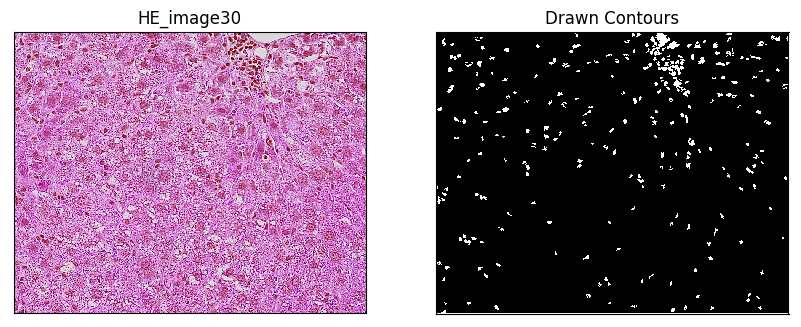

Size of Clusters: 494
Current number of clusters: 112
Current number of clusters: 1


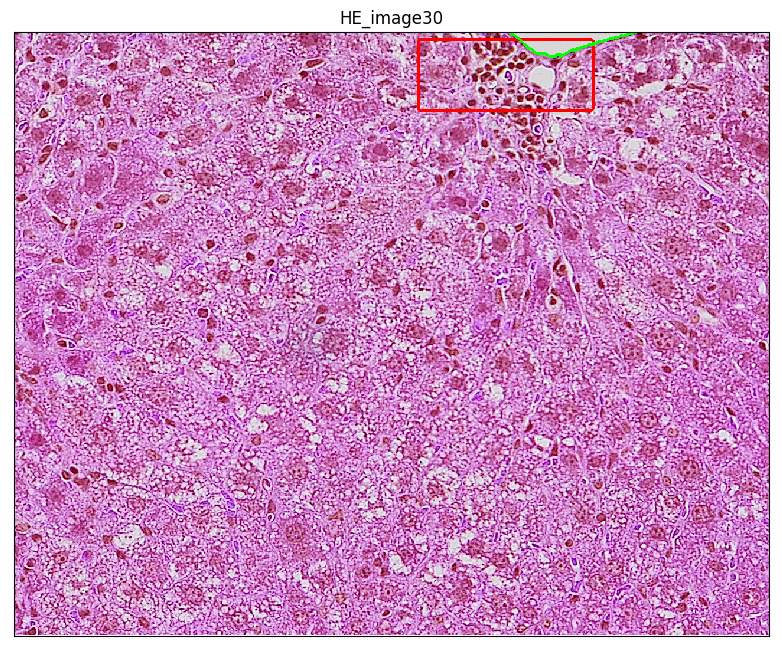

Size of Centroids: 211


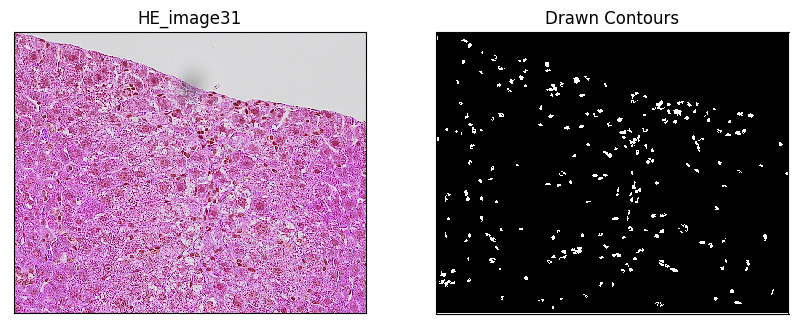

Size of Clusters: 403
Current number of clusters: 92
Current number of clusters: 0


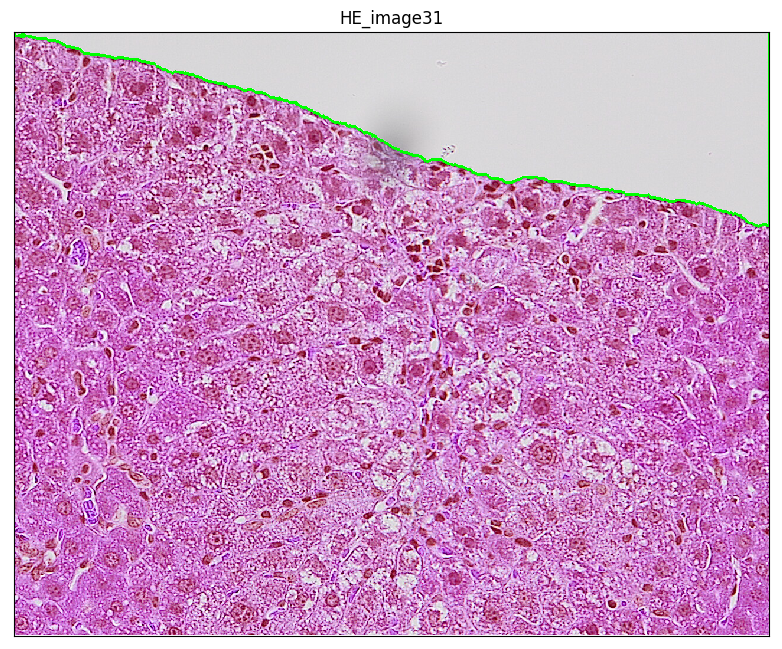

Size of Centroids: 152


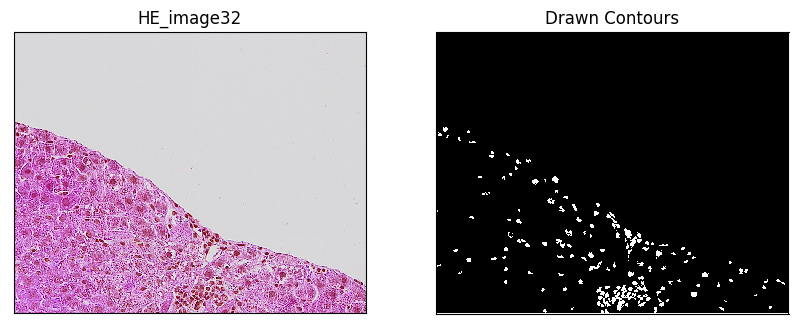

Size of Clusters: 379
Current number of clusters: 46
Current number of clusters: 3


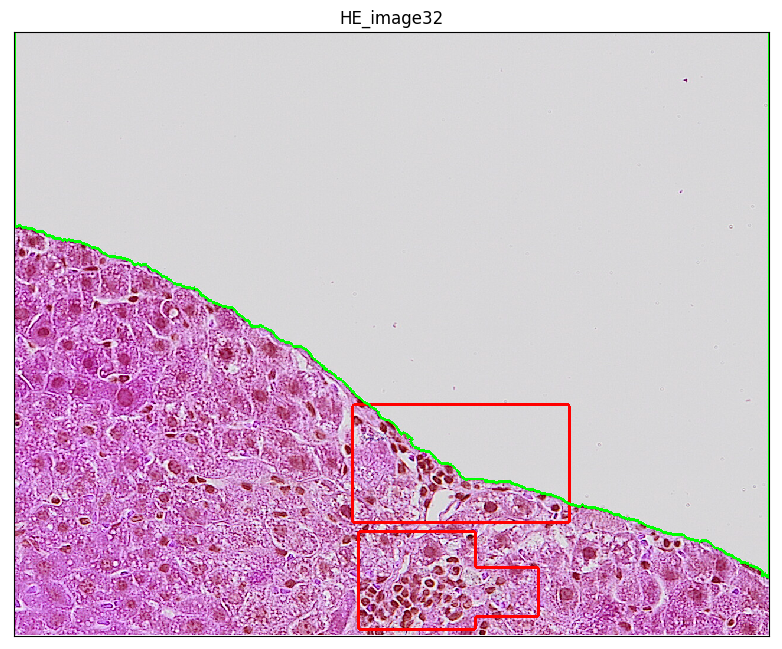

Size of Centroids: 3


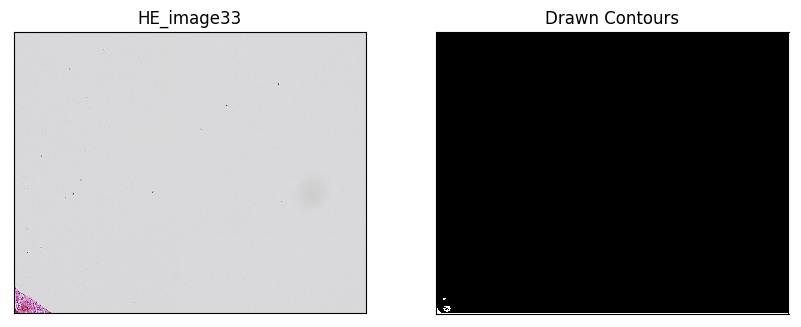

Size of Clusters: 6
Current number of clusters: 1
Current number of clusters: 0


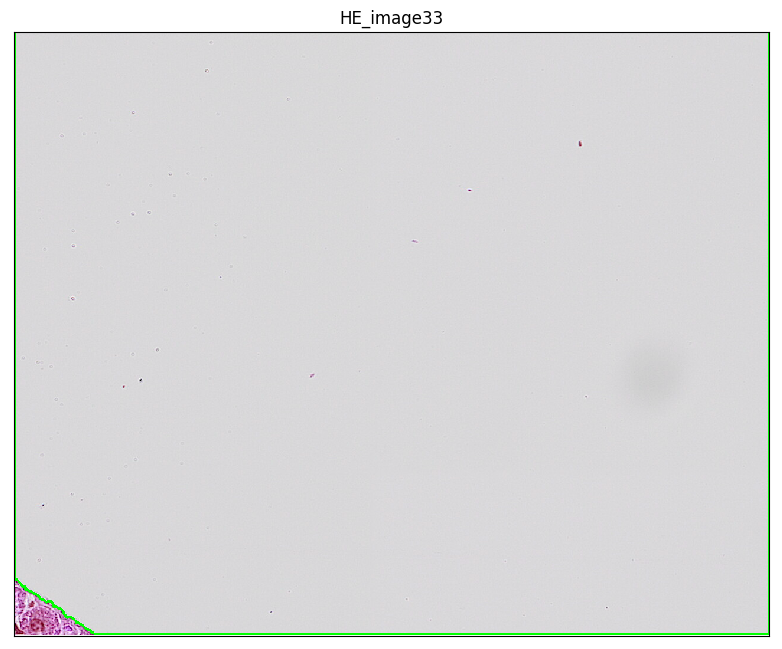

Size of Centroids: 0


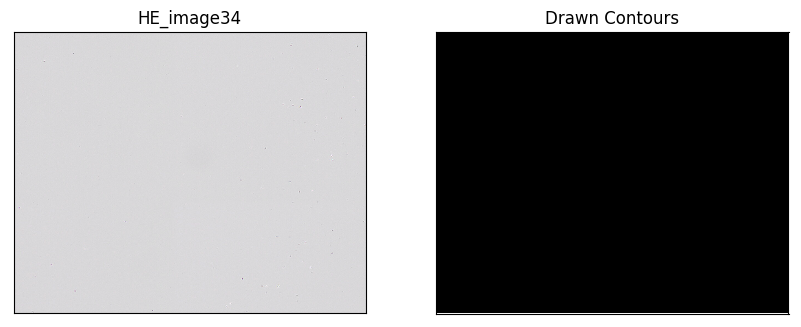

Size of Clusters: 0
Current number of clusters: 0
Current number of clusters: 0


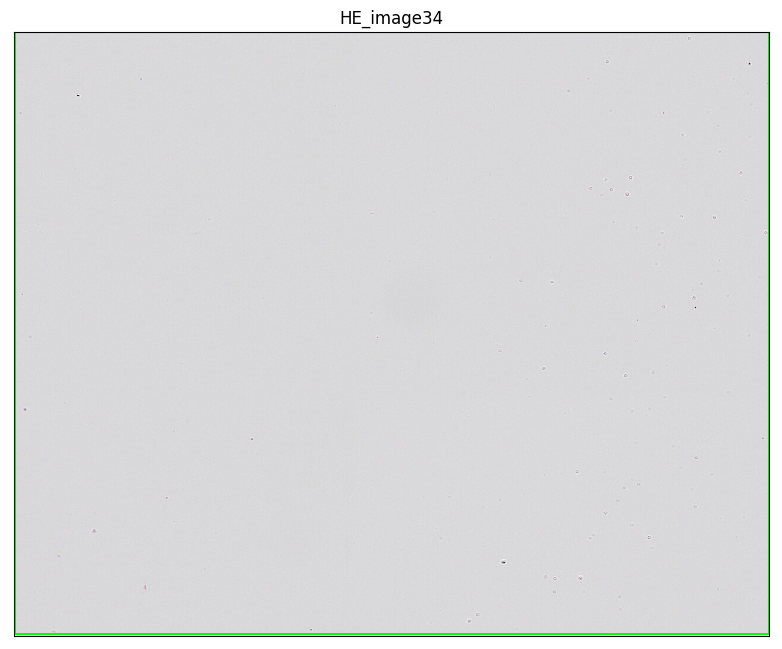

Size of Centroids: 216


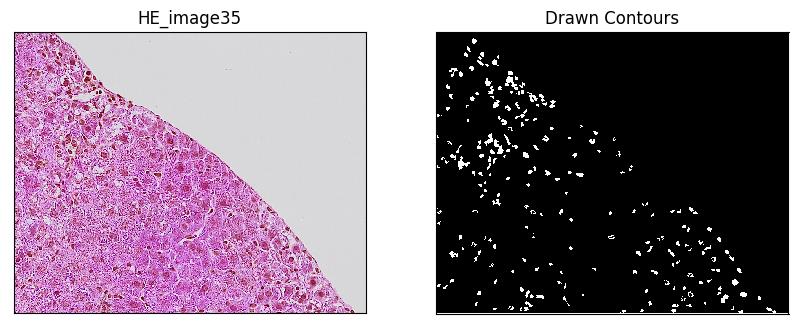

Size of Clusters: 479
Current number of clusters: 70
Current number of clusters: 2


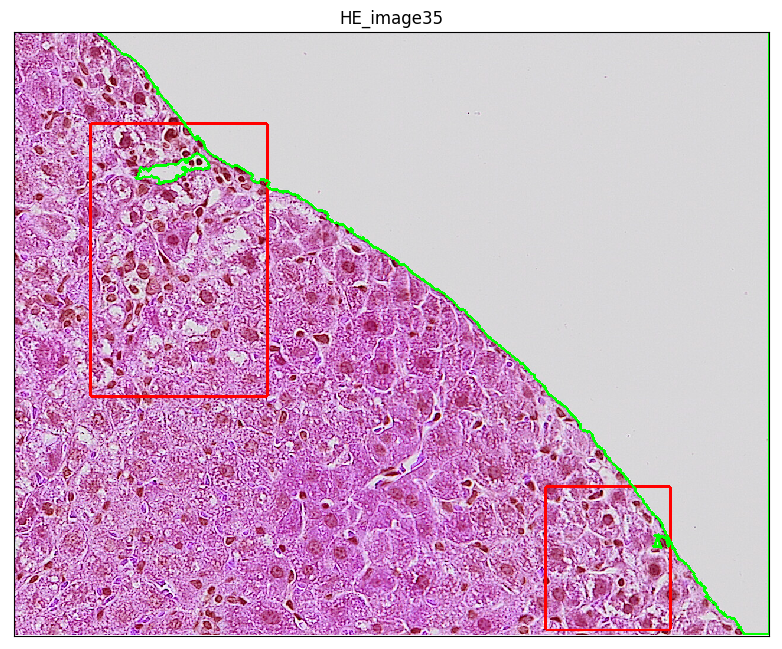

Size of Centroids: 294


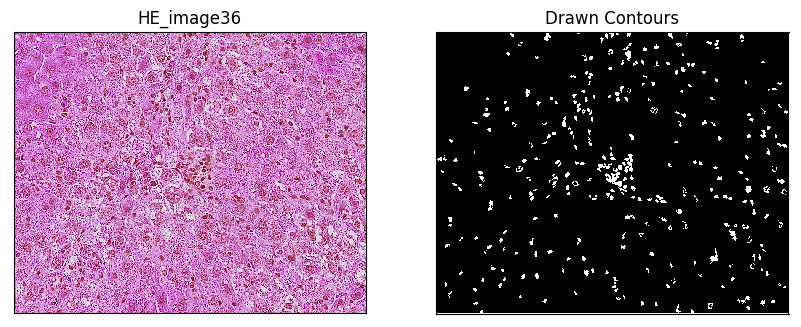

Size of Clusters: 566
Current number of clusters: 124
Current number of clusters: 2


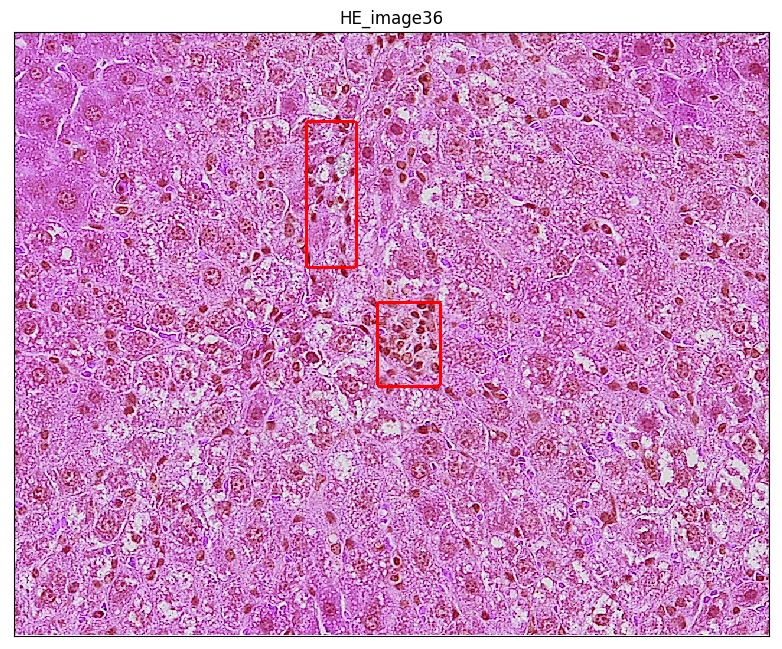

Size of Centroids: 162


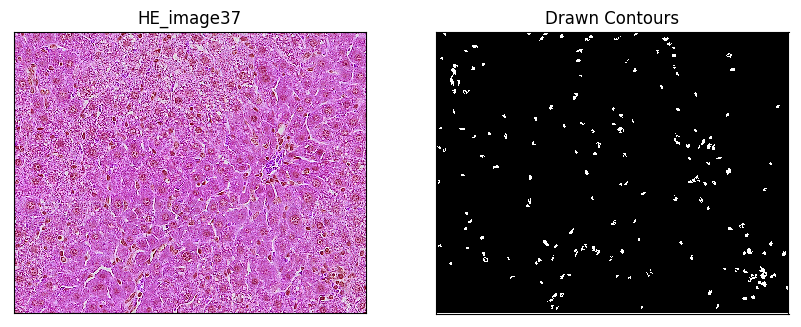

Size of Clusters: 253
Current number of clusters: 94
Current number of clusters: 0


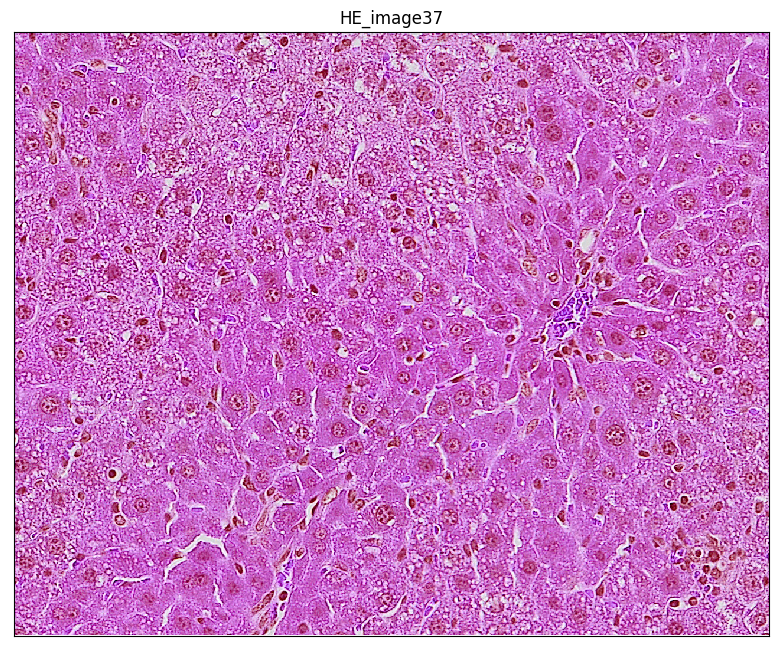

Size of Centroids: 134


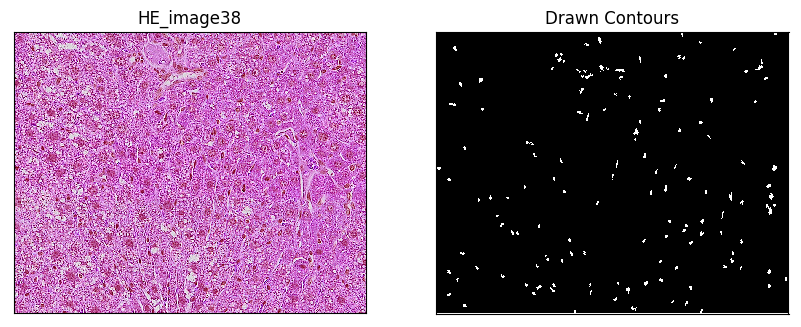

Size of Clusters: 188
Current number of clusters: 91
Current number of clusters: 0


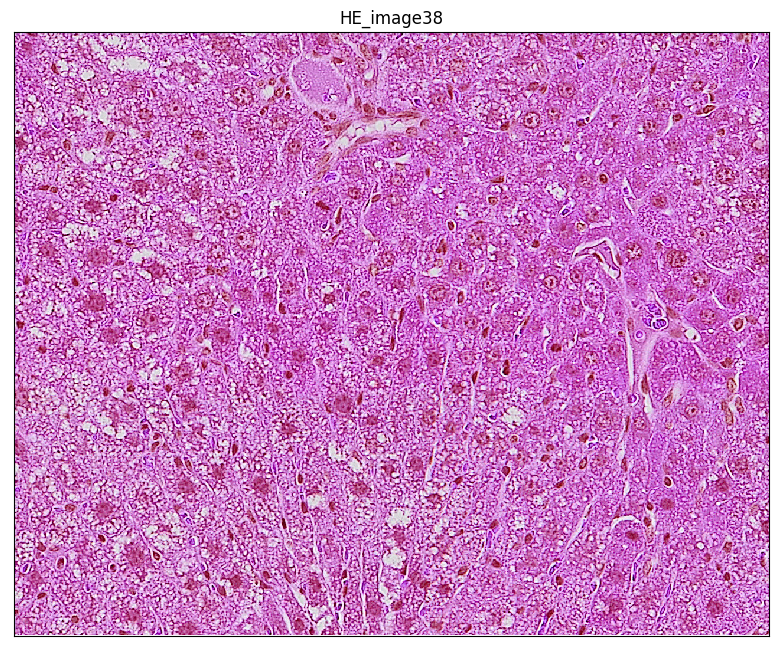

Size of Centroids: 195


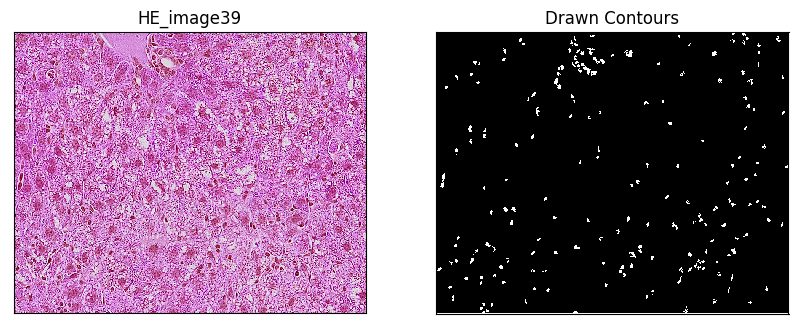

Size of Clusters: 361
Current number of clusters: 99
Current number of clusters: 0


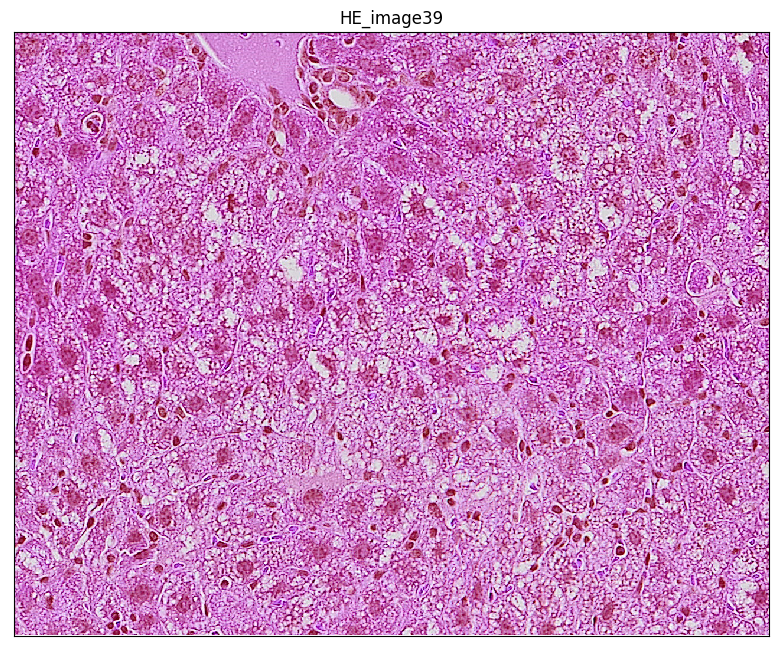

Size of Centroids: 247


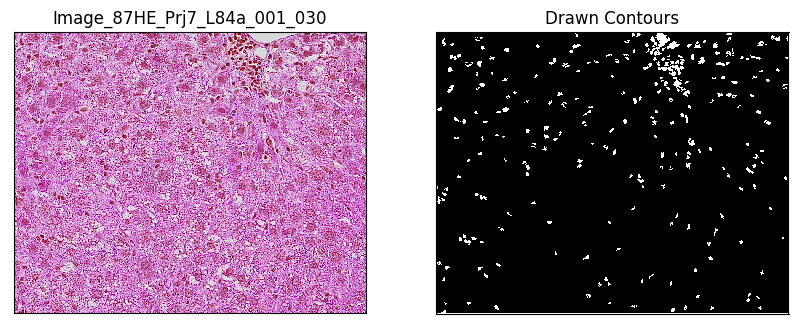

Size of Clusters: 494
Current number of clusters: 112
Current number of clusters: 1


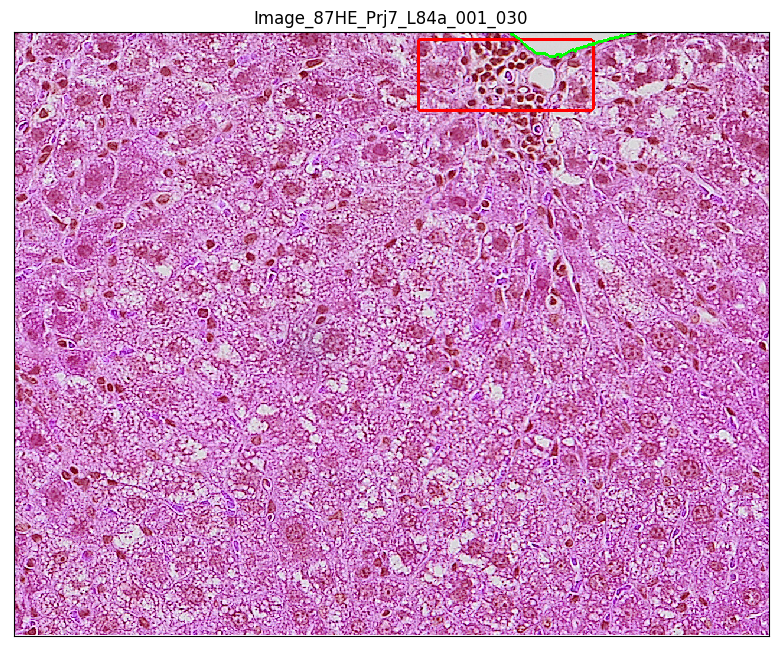

Size of Centroids: 211


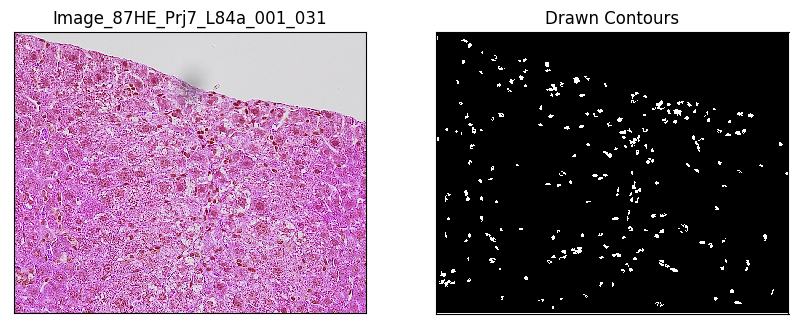

Size of Clusters: 403
Current number of clusters: 92
Current number of clusters: 0


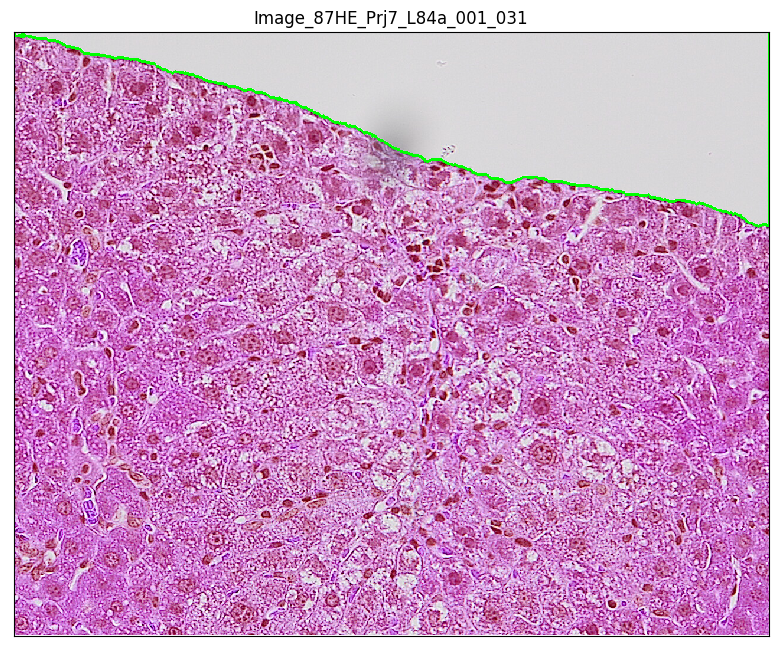

Size of Centroids: 152


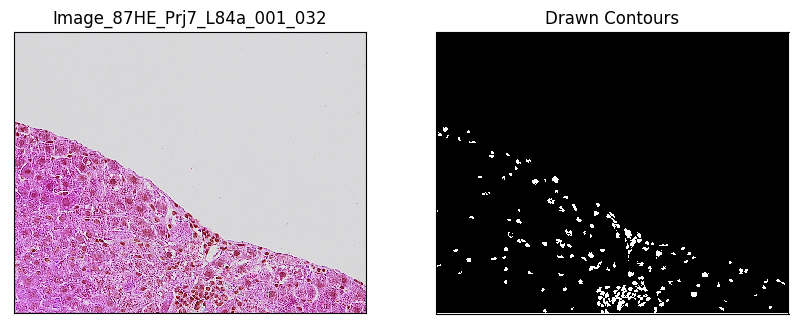

Size of Clusters: 379
Current number of clusters: 46
Current number of clusters: 3


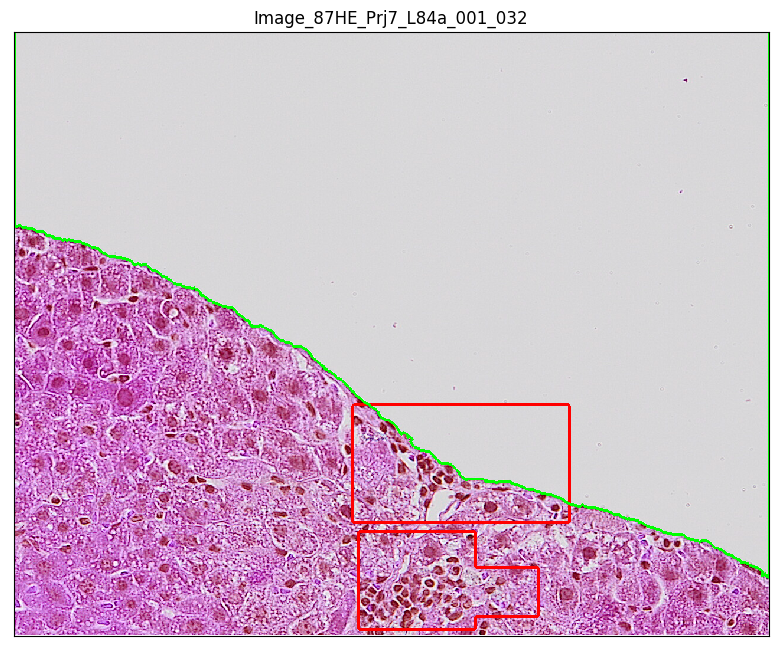

Size of Centroids: 3


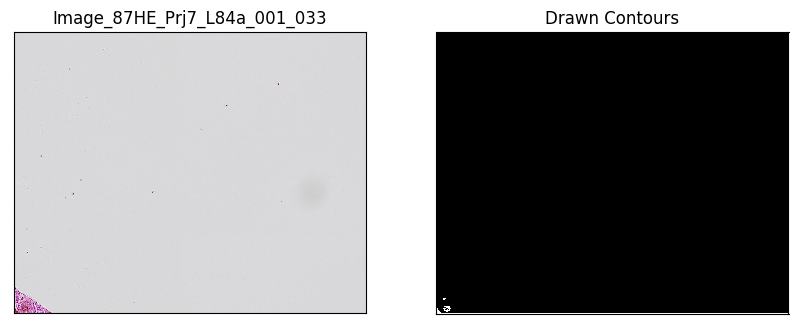

Size of Clusters: 6
Current number of clusters: 1
Current number of clusters: 0


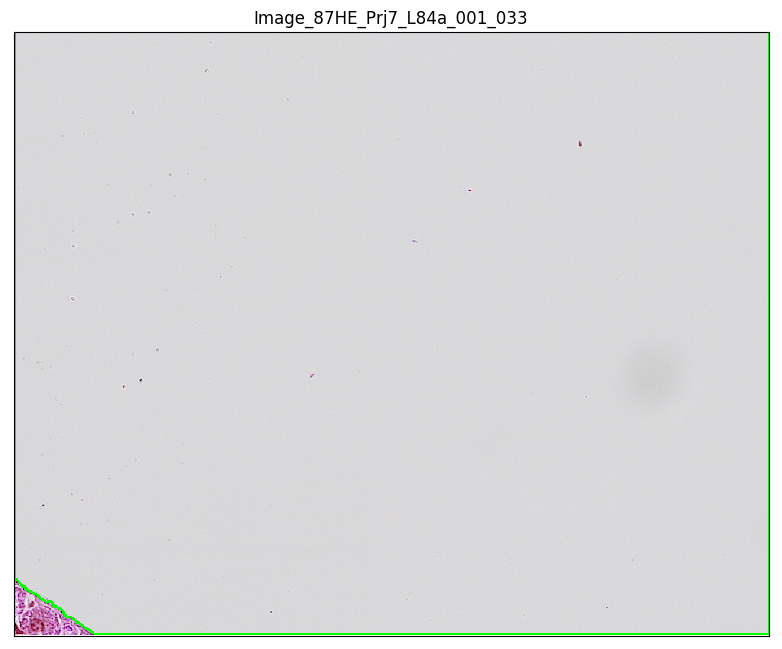

Size of Centroids: 0


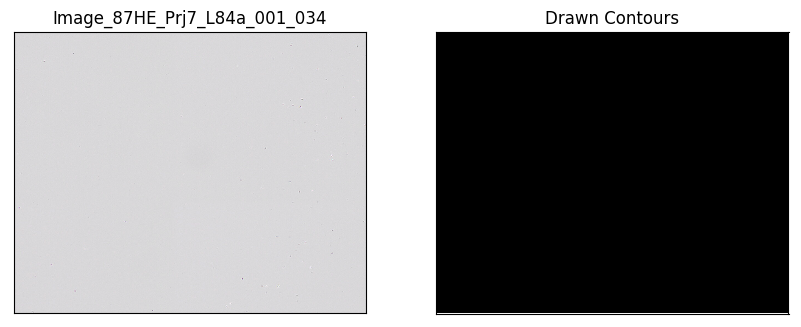

Size of Clusters: 0
Current number of clusters: 0
Current number of clusters: 0


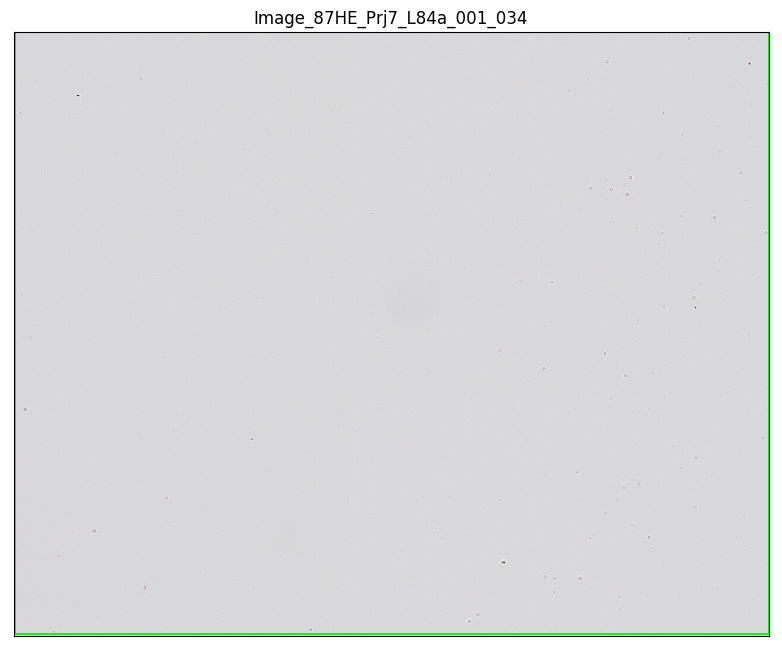

Size of Centroids: 216


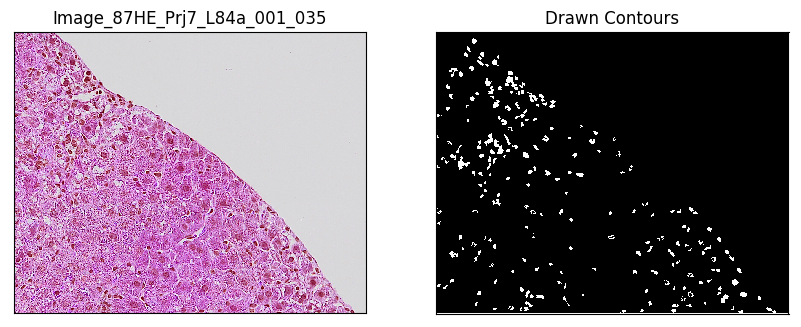

Size of Clusters: 479
Current number of clusters: 70
Current number of clusters: 2


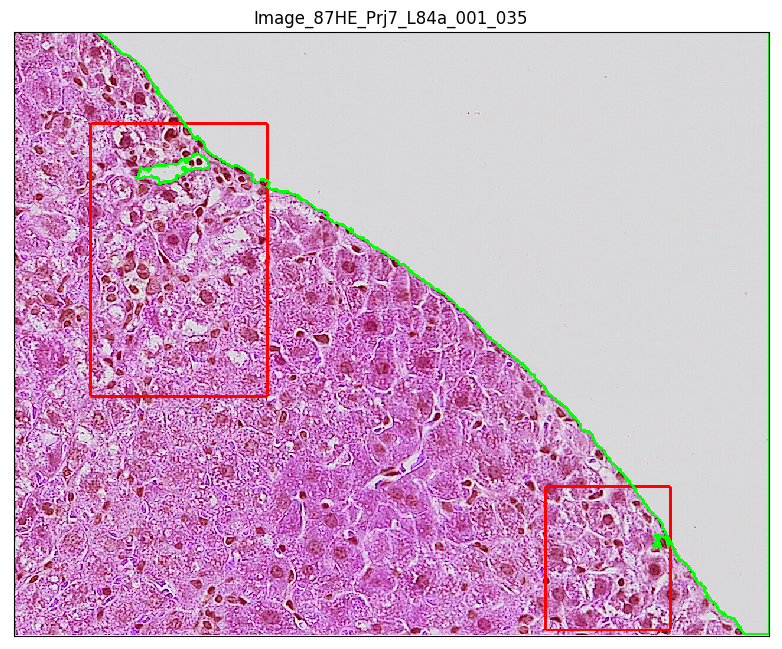

Size of Centroids: 294


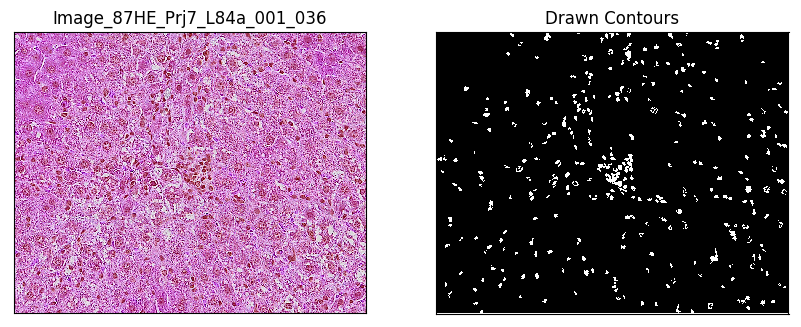

Size of Clusters: 566
Current number of clusters: 124
Current number of clusters: 2


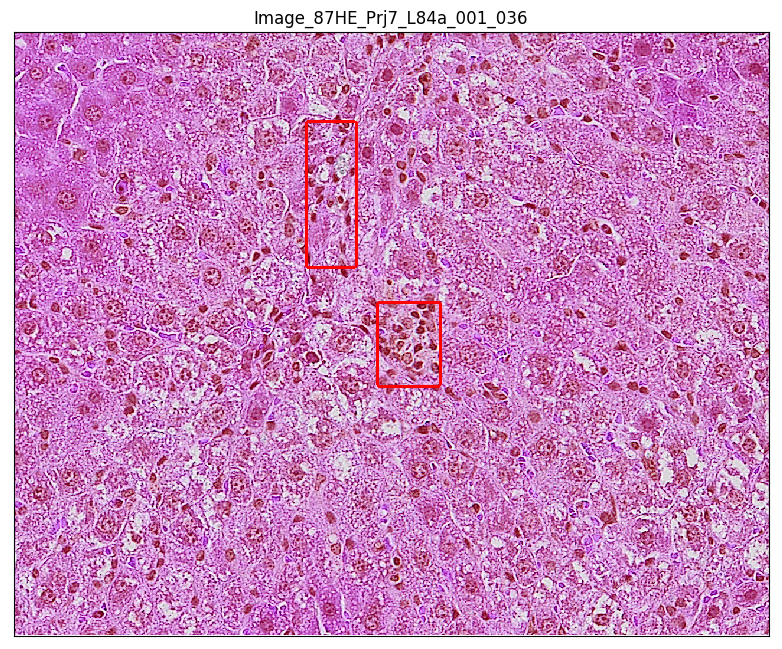

Size of Centroids: 162


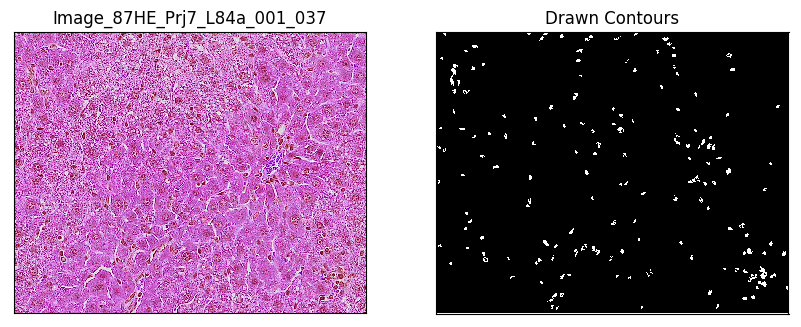

Size of Clusters: 253
Current number of clusters: 94
Current number of clusters: 0


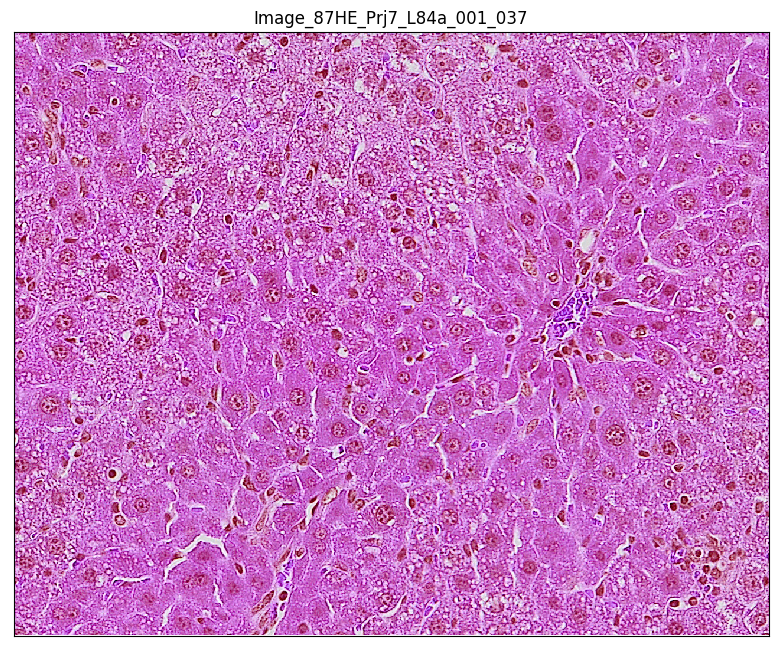

Size of Centroids: 134


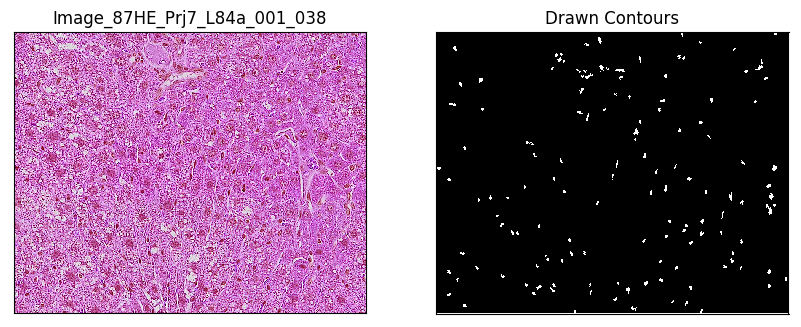

Size of Clusters: 188
Current number of clusters: 91
Current number of clusters: 0


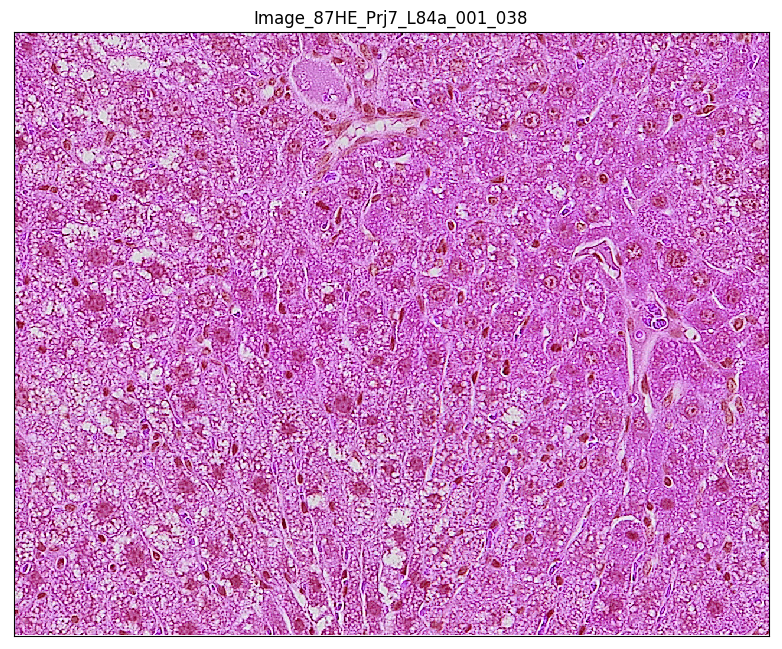

Size of Centroids: 195


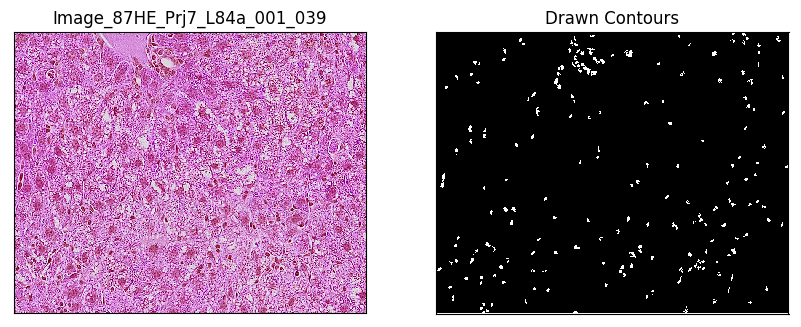

Size of Clusters: 361
Current number of clusters: 99
Current number of clusters: 0


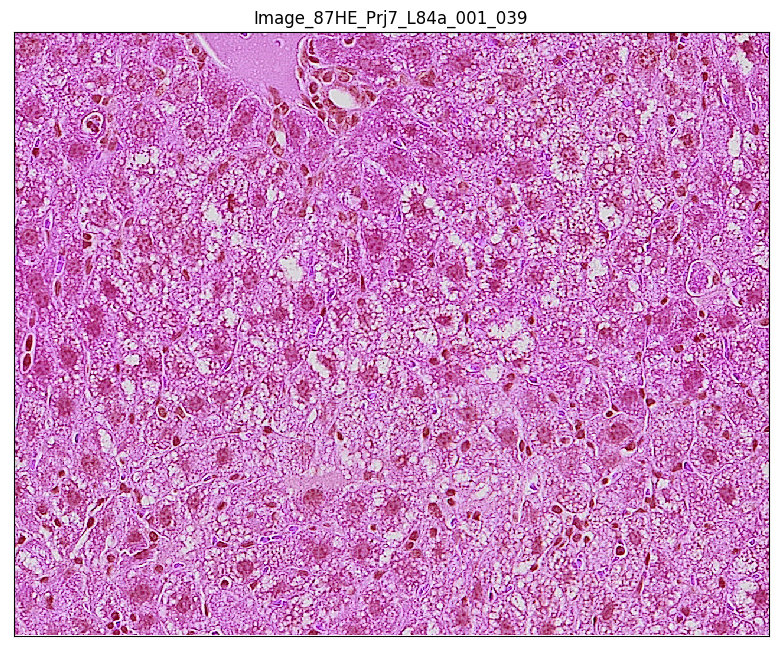

In [5]:
def main():
    fs = open('HE_Results.txt', 'w')
    fs.write('\nFile Name\tCluster No.\tNo. of Cells in Cluster\tCluster Size\n\n')
    file_path = os.listdir("../Images/")
    for infile in file_path:
        if (infile[-4:] == ".tif" and 'HE' in infile):
            (img, cluster_results, nuclei_img) = Image_Processing(infile)
            cv2.imwrite('./HE_Pngs/' + infile[:-4] + '.png', img)
            cv2.imwrite('./HE_Mask/'+ infile[:-4]+'_mask.png', nuclei_img)
            if len(cluster_results) == 0:
                fs.write(infile[:-4]+'\t0\t0\t0\n')
            else:
                for a in cluster_results:
                    fs.write(infile[:-4]+'\t'+str(a)+'\t'+str(cluster_results[a][0])+'\t'+str(cluster_results[a][1])+'\n') 
    fs.close()
main()